In [3]:
# Your imports
import os
import pandas as pd

%matplotlib inline
import string
import sys
from collections import deque

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import xgboost as xgb

# data
from sklearn.compose import ColumnTransformer, make_column_transformer

# Classifiers
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer

# classifiers / models
from sklearn.linear_model import LogisticRegression

# other
from sklearn.model_selection import (
    GridSearchCV,
    RandomizedSearchCV,
    cross_val_score,
    cross_validate,
    train_test_split,
)
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeRegressor, export_graphviz

import altair as alt
alt.renderers.enable('mimetype')

RendererRegistry.enable('mimetype')

## 1. Understanding the problem <a name="1"></a>
<hr>

In this miniproject we would use the data from [Default of Credit Card Clients Dataset](https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset). to see how well we could predict if a person would default their credit card or not. 

In [276]:
data = pd.read_csv('UCI_Credit_Card.csv')
data

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000.0,1,3,1,39,0,0,0,0,...,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0,0
29996,29997,150000.0,1,3,2,43,-1,-1,-1,-1,...,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0,0
29997,29998,30000.0,1,2,2,37,4,3,2,-1,...,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0,1
29998,29999,80000.0,1,3,1,41,1,-1,0,0,...,52774.0,11855.0,48944.0,85900.0,3409.0,1178.0,1926.0,52964.0,1804.0,1


I was looking at the data for a while to see if all the features make sense. After looking at them a while except ID I believe the rest of the features are useful. Also Somethings that it better have been noted was that although sex is not binary and it was only considered binary for the use in prediction. My other thoughts are that maybe some better information about the users could have also been used like the amount they had in their bank account and estimated assets of each of their costumers. 

## 2. Data splitting <a name="2"></a>
<hr>


In [277]:
train_data , test_data = train_test_split(data,test_size=0.2,random_state=123)
X_train , y_train = train_data.iloc[:,:-1] , train_data.iloc[:,-1]
X_test , y_test = test_data.iloc[:,:-1] , test_data.iloc[:,-1]

A 20% test split was used just based because it is a standard and because the data isn't gigantic using a smaller test split might not be a good idea because the test score might not be a true representative of the deployment score.

## 3. EDA <a name="3"></a>
<hr>

### First it has to be checked if there are not missing values in the data. 

In [278]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24000 entries, 19682 to 19966
Data columns (total 25 columns):
ID                            24000 non-null int64
LIMIT_BAL                     24000 non-null float64
SEX                           24000 non-null int64
EDUCATION                     24000 non-null int64
MARRIAGE                      24000 non-null int64
AGE                           24000 non-null int64
PAY_0                         24000 non-null int64
PAY_2                         24000 non-null int64
PAY_3                         24000 non-null int64
PAY_4                         24000 non-null int64
PAY_5                         24000 non-null int64
PAY_6                         24000 non-null int64
BILL_AMT1                     24000 non-null float64
BILL_AMT2                     24000 non-null float64
BILL_AMT3                     24000 non-null float64
BILL_AMT4                     24000 non-null float64
BILL_AMT5                     24000 non-null float64
BILL_AMT

### By looking at the data there is no missing value which is great for us. Less need for us to to tackle the problem of dealing with missing values.

### Let's also take a look at the mean and percentile of columns to get an idea of their means and ranges and if a scaling is required.

In [279]:
train_data.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,...,24000.000000,24000.000000,24000.000000,24000.000000,2.400000e+04,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000
mean,14964.174292,167893.486667,1.603125,1.851958,1.553375,35.488458,-0.017542,-0.135292,-0.170042,-0.224292,...,43389.105625,40297.970375,38708.777542,5656.319917,5.910454e+03,5280.658708,4763.854250,4805.837667,5277.577958,0.222167
std,8660.479272,130109.666875,0.489260,0.790560,0.521452,9.217424,1.125331,1.199812,1.201709,1.170630,...,64572.844994,60878.153831,59355.284889,16757.718059,2.134743e+04,17973.951980,15162.056345,15251.828322,18222.046645,0.415711
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-65167.000000,-61372.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7467.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2310.000000,1744.250000,1200.000000,990.000000,8.150000e+02,390.000000,281.750000,234.000000,110.750000,0.000000
50%,14975.000000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,19032.000000,18019.000000,16812.500000,2100.000000,2.010000e+03,1801.500000,1500.000000,1500.000000,1500.000000,0.000000
75%,22460.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,54591.500000,50237.250000,49132.750000,5009.000000,5.000000e+03,4600.000000,4026.000000,4009.250000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.227082e+06,896040.000000,621000.000000,426529.000000,528666.000000,1.000000


### With The above dataframe it can be concluded that the data is not scaled and some scaling is required for the dataset in the preprocessing step.

### By looking at the meta data in kaggle it looks like some data is missing in the education column but they are not null and they are filled showed with numbers 4 , 5 and 6. Let's take a look to see how many of those data are present.

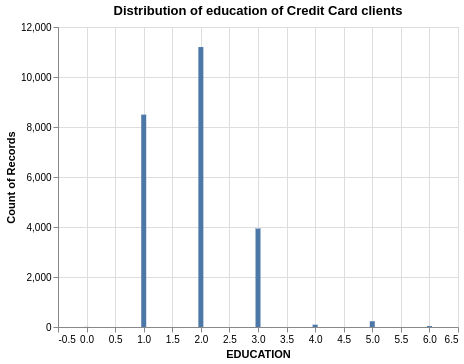

In [332]:
alt.data_transformers.disable_max_rows()
alt.Chart(
    train_data, title="Distribution of education of Credit Card clients"
).mark_bar().encode(alt.X("EDUCATION"), alt.Y("count()"))

### There aren't many rows in the 4, 5 and 6 columns so let's get an exact count of those columns.

In [281]:
len(train_data.query("EDUCATION > 3.0")) / len(train_data)

0.014958333333333334

### Based on this low number, including the values 4,5,6 and changing them to the median or to keep them as they are should be explored further.

### Let's also take a look into the age distribution to get an idea of which age we have the most data for.

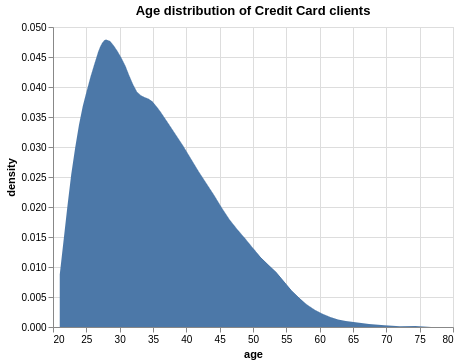

In [333]:
alt.Chart(
    train_data, title="Age distribution of Credit Card clients"
).transform_density("AGE", as_=["age", "density"]).mark_area(
    interpolate="monotone"
).encode(
    alt.X("age:Q"), alt.Y("density:Q")
)

### We could see the age around 30 is the most dense, and it gradually starts to decrease towards the older age which is a sign that there is data present for most of the ages and the data is present for all the ranges.

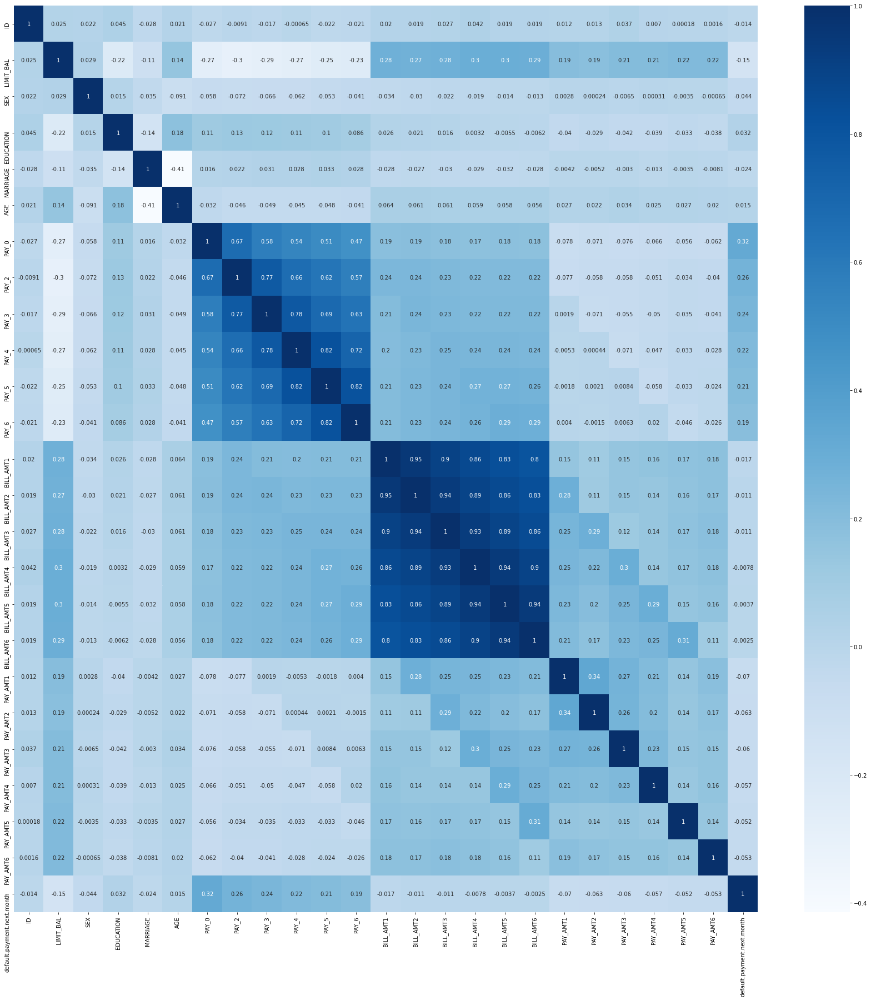

In [283]:
import seaborn as sns

train_data_cor = train_data.corr()
plt.figure(figsize=(30, 30))
sns.heatmap(train_data_cor, annot=True, cmap=plt.cm.Blues)
plt.show()

### From the above plot it can be concluded that the payments and bills for all the months are highly correlated therefore it might be a good idea to explore if all of them are necessary to have a good prediction (This would become apparent in the feature selection step). Also there looks like there is a big correlation between the pay feature and the default payment target and in the first glance it looks like it might be useful to improve the model. 

### Lastly we need to see if there is any imbalance for the target.

In [284]:
(train_data.groupby("default.payment.next.month").count() / len(train_data))["ID"]

default.payment.next.month
0    0.777833
1    0.222167
Name: ID, dtype: float64

## Firstly there is an inbalance in the target therefore using accuracy here might not be the best idea. Because having a default would be really bad for the credit card company it would be really important to identify them. The best metric here to use is probably not either f1 score or recall or accuracy. The reason is that we need to have an average finanical impact of someone defaulting their credit card and also the potential loss of the company if someone was incorrectly labeled as a defaulter. Then by having the proportion of people that default and people who don't create a custom metric which aims to maximize the credit card or banks financial gain. I did search for the numbers in this area but unfortunetly they were not public so I believe the best metric here would be a custom one for our purpose. Based on the fact that. Just based on the result that credit card companies are making 20% from the loans they give but they almost have a huge short term loss (here we think that people will not return the money at all so 100%) and that the proportion of people who don't default is about 80% we would go for f1_score. Again this is not the best metric here but there is no other choice because of lack of data.

## 4. Feature engineering <a name="4"></a>
<hr>


## Something I do suspect that might improve the model is changing the education into an ordinal feature (Reason stated in EDA). The way we might approach this is to change the values of 4,5,6 to the median which is 2. This way there is an order in the education level of all the people in the data. We would keep the EDUCATION column as a categorical but also add an EDUCATION_ORD and later see if it is more effective than EDUCATION or not. The EDUCATION column would be treated as a categorical value in the training data not an ordinal feature.

## Also another feature that I'm not sure is helpful or not but needs to be explored further is the exponential of the columns that are based on money amount. By using the exponential we are exploring if they have a non linear effect or not (We scale them a little bit before passing them to the exponential function).

In [285]:
# We are trying to make a column of education that is oridinal but doesen't have those rarely occuring missing values equal to median
X_train["EDUCATION_ORD_Changed"] = X_train["EDUCATION"]
X_train.loc[X_train["EDUCATION_ORD_Changed"] > 3, "EDUCATION_ORD_Changed"] = 2
X_train.loc[X_train["EDUCATION_ORD_Changed"] == 0, "EDUCATION_ORD_Changed"] = 2
# Lets try to have one ordinal one as well.
X_train["EDUCATION_ORD"] = X_train["EDUCATION"]

# Now lets add the log of the money columns.
for cols in list(X_train.loc[:, "PAY_0":"PAY_AMT6"].columns):
    X_train[f"e_{cols}"] = np.exp(X_train[cols] / 100000)

X_train

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,e_BILL_AMT3,e_BILL_AMT4,e_BILL_AMT5,e_BILL_AMT6,e_PAY_AMT1,e_PAY_AMT2,e_PAY_AMT3,e_PAY_AMT4,e_PAY_AMT5,e_PAY_AMT6
19682,19683,200000.0,2,2,1,46,0,0,0,0,...,2.833096,2.812911,2.591042,1.917611,1.037610,1.051271,1.033551,1.025315,1.029733,1.015113
11062,11063,120000.0,2,1,1,32,-1,-1,-1,-1,...,1.003265,1.004771,1.008052,1.003265,1.006541,1.003265,1.004771,1.008052,1.000000,1.003265
197,198,20000.0,2,1,2,22,0,0,0,0,...,1.210036,1.086890,1.207654,1.212240,1.015113,1.010373,1.005425,1.221403,1.006954,1.010050
23620,23621,100000.0,2,5,2,34,0,0,0,0,...,2.392742,1.260880,1.080269,1.032714,1.051313,1.038845,1.030475,1.040811,1.032714,1.018815
26031,26032,290000.0,2,2,2,29,0,0,0,0,...,1.087509,1.091661,1.095762,1.105348,1.011364,1.015133,1.013085,1.005013,1.010050,1.010060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28636,28637,380000.0,2,2,1,37,0,0,0,0,...,1.141987,1.153626,1.172913,1.168312,1.012113,1.013085,1.012497,1.019182,1.000000,1.030455
17730,17731,360000.0,2,1,1,54,1,-2,-2,-1,...,1.000000,1.026136,1.026136,1.071876,1.000000,1.000000,1.026136,1.000000,1.071876,1.000000
28030,28031,50000.0,2,3,1,29,0,0,0,0,...,1.596430,1.483197,1.092250,1.094273,1.020222,1.020201,1.015418,1.010050,1.003275,1.003295
15725,15726,30000.0,2,2,2,21,0,0,0,0,...,1.342254,1.361259,1.342240,1.180160,1.020201,1.020201,1.020201,1.017807,1.003315,1.000000


In [286]:
# Changing the test set just like above

X_test["EDUCATION_ORD_Changed"] = X_test["EDUCATION"]
X_test.loc[X_test["EDUCATION_ORD_Changed"] > 3, "EDUCATION_ORD_Changed"] = 2
X_test.loc[X_test["EDUCATION_ORD_Changed"] == 0, "EDUCATION_ORD_Changed"] = 2

X_test["EDUCATION_ORD"] = X_test["EDUCATION"]

for cols in list(X_test.loc[:, "PAY_0":"PAY_AMT6"].columns):
    X_test[f"e_{cols}"] = np.exp(X_test[cols] / 100000)

## 5. Preprocessing and transformations <a name="5"></a>
<hr>

In [287]:
drop_cols = ["ID"]
# Although EDUCATION_ORD and EDUCATION_ORD_Changed are ordinal features they are already encoded so no need to turn them to ordinal ones again.
numeric_cols = list(X_train.columns)
numeric_cols.remove("EDUCATION")
numeric_cols.remove("ID")
category_cols = ["EDUCATION"]
col_transformer = ColumnTransformer(
    [("num", StandardScaler(), numeric_cols), ("cat", OneHotEncoder(), category_cols)],
    remainder="drop",
)

## 6. Baseline model <a name="6"></a>
<hr>

In [288]:
model_f1 = {}
model_std = {}
pipe = make_pipeline(col_transformer, DummyClassifier())
res = pd.DataFrame(
    cross_validate(
        pipe, X_train, y_train, cv=10, n_jobs=-1, scoring=["recall", "f1", "accuracy"]
    )
).mean()
pd.DataFrame(
    cross_validate(
        pipe, X_train, y_train, cv=10, n_jobs=-1, scoring=["recall", "f1", "accuracy"]
    )
).mean()

fit_time         0.073051
score_time       0.015682
test_recall      0.223368
test_f1          0.224663
test_accuracy    0.657583
dtype: float64

In [289]:
model_f1["Dummy"] = res["test_f1"]
model_std["Dummy"] = pd.DataFrame(
    cross_validate(
        pipe, X_train, y_train, cv=10, n_jobs=-1, scoring=["recall", "f1", "accuracy"]
    )
).std()["test_f1"]

## 7. Linear models <a name="7"></a>
<hr>


In [290]:
pipe = make_pipeline(
    col_transformer,
    LogisticRegression(max_iter=1000, class_weight="balanced", random_state=123),
)
results = {}
params = {
    "logisticregression__penalty": ["l1", "l2", "none"],
    "logisticregression__C": [10 ** pow for pow in range(-2, 2)],
    #     "logisticregression__class_weight": [
    #         {0: 1, 1: 1},
    #         {0: 1, 1: 2},
    #         {0: 1, 1: 3},
    #         {0: 2, 1: 1},
    #         {0: 3, 1: 1},
    #         "balanced",
    #     ],
    "logisticregression__solver": [
        "newton-cg",
        "saga",
    ],
}
search = GridSearchCV(pipe, param_grid=params, cv=10, n_jobs=-1, scoring="f1")
res = search.fit(X_train, y_train)
lin_res = res.cv_results_.copy()
# pd.DataFrame(cross_validate(pipe,X_train,y_train,cv=10,n_jobs=-1,return_train_score=True,scoring=['recall','f1','accuracy'])).mean()

Setting penalty='none' will ignore the C and l1_ratio parameters
The line search algorithm did not converge
The line search algorithm did not converge
The line search algorithm did not converge
The line search algorithm did not converge
The line search algorithm did not converge
The line search algorithm did not converge
The line search algorithm did not converge
Line Search failed


In [291]:
pd.DataFrame(res.cv_results_).sort_values(by="mean_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_logisticregression__C,param_logisticregression__penalty,param_logisticregression__solver,params,split0_test_score,split1_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
13,46.094630,2.956700,0.011977,0.002442,1,l1,saga,"{'logisticregression__C': 1, 'logisticregressi...",0.461222,0.472376,...,0.460777,0.468556,0.457064,0.516610,0.477755,0.481151,0.486449,0.475384,0.016366,20
11,33.286631,1.479918,0.012976,0.003488,0.1,none,saga,"{'logisticregression__C': 0.1, 'logisticregres...",0.462594,0.472050,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475530,0.016246,16
17,35.869648,1.856670,0.020540,0.011531,1,none,saga,"{'logisticregression__C': 1, 'logisticregressi...",0.462594,0.472050,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475530,0.016246,16
5,31.155659,1.542619,0.012177,0.002085,0.01,none,saga,"{'logisticregression__C': 0.01, 'logisticregre...",0.462594,0.472050,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475530,0.016246,16
23,33.819654,5.239204,0.013059,0.005037,10,none,saga,"{'logisticregression__C': 10, 'logisticregress...",0.462594,0.472050,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475530,0.016246,16
15,34.149440,3.285001,0.018771,0.010242,1,l2,saga,"{'logisticregression__C': 1, 'logisticregressi...",0.462594,0.472376,...,0.460777,0.468880,0.456432,0.516260,0.478082,0.481481,0.486449,0.475561,0.016231,15
19,48.732376,0.992948,0.021970,0.016184,10,l1,saga,"{'logisticregression__C': 10, 'logisticregress...",0.462594,0.472376,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475562,0.016239,13
21,37.012429,2.217291,0.018597,0.009439,10,l2,saga,"{'logisticregression__C': 10, 'logisticregress...",0.462594,0.472376,...,0.461103,0.468880,0.456116,0.516260,0.478082,0.481481,0.486449,0.475562,0.016239,13
8,1.244051,0.198050,0.015409,0.006039,0.1,l2,newton-cg,"{'logisticregression__C': 0.1, 'logisticregres...",0.460274,0.472376,...,0.458807,0.468556,0.461538,0.517966,0.482192,0.475735,0.485477,0.475682,0.016472,12
20,3.604954,0.798122,0.013104,0.003814,10,l2,newton-cg,"{'logisticregression__C': 10, 'logisticregress...",0.465940,0.472376,...,0.458832,0.469289,0.462810,0.515172,0.480599,0.471467,0.486072,0.475685,0.015191,11


# Note: Although netown-cg does not work for l1 penalty we will leave it there because we are not spending 0 resources because it will automatically skip training.

## the best model in terms of mean cross validation score is : 

In [292]:
res.best_score_

0.5337996576477618

In [293]:
model_f1["Logistic_regression"] = res.best_score_
model_std["Logistic_regression"] = res.cv_results_["std_test_score"][res.best_index_]

## 8. Different classifiers <a name="8"></a>
<hr>

# Using Catboost:

In [294]:
# Function used from lab 3 course 573 author Varada Kolhatkar
# Changed to report f1 score
def mean_std_cross_val_scores(model, X_train, y_train, **kwargs):
    """
    Returns mean and std of cross validation
    """
    scores = cross_validate(model, X_train, y_train, scoring="f1", **kwargs)

    mean_scores = pd.DataFrame(scores).mean()
    std_scores = pd.DataFrame(scores).std()
    out_col = []

    for i in range(len(mean_scores)):
        out_col.append((f"%0.3f (+/- %0.3f)" % (mean_scores[i], std_scores[i])))

    return pd.Series(data=out_col, index=mean_scores.index)


from catboost import CatBoostClassifier

In [295]:
pipe = make_pipeline(
    col_transformer,
    CatBoostClassifier(
        random_state=123, verbose=0, auto_class_weights="Balanced", eval_metric="F1"
    ),
)
results = {}
results["CatBoost"] = mean_std_cross_val_scores(
    pipe, X_train, y_train, return_train_score=True, cv=10
)
pd.DataFrame(results)

,CatBoost
fit_time,16.870 (+/- 0.382)
score_time,0.029 (+/- 0.006)
test_score,0.536 (+/- 0.015)
train_score,0.675 (+/- 0.003)


In [296]:
results = cross_validate(
    pipe, X_train, y_train, scoring="f1", return_train_score=True, cv=10
)

In [297]:
model_f1["CatBoost"] = np.array(results["test_score"]).mean()
model_std["CatBoost"] = np.array(results["test_score"]).std()

# Using Neural Network

In [298]:
from sklearn.neural_network import MLPClassifier
from skopt import BayesSearchCV

In [299]:
pipe = make_pipeline(col_transformer, MLPClassifier(random_state=123, max_iter=1000))
results = {}
params = {
    "mlpclassifier__learning_rate": ["constant", "invscaling", "adaptive"],
    "mlpclassifier__activation": ["logistic", "tanh", "relu"],
    "mlpclassifier__hidden_layer_sizes": [
        (30,),
        (10, 10),
        (20, 20),
        (30, 30),
        (40, 40),
        (50, 50),
    ],
}
search = RandomizedSearchCV(pipe, params, cv=10, n_jobs=-1, scoring="f1", n_iter=30)
res = search.fit(X_train, y_train)
ann_res = res.cv_results_.copy()

In [300]:
pd.DataFrame(res.cv_results_).sort_values(by="mean_test_score",ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_mlpclassifier__learning_rate,param_mlpclassifier__hidden_layer_sizes,param_mlpclassifier__activation,params,split0_test_score,split1_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
15,40.721666,6.750244,0.016444,0.000372,adaptive,"(20, 20)",logistic,"{'mlpclassifier__learning_rate': 'adaptive', '...",0.470035,0.454653,...,0.473876,0.466272,0.461911,0.511405,0.499414,0.460220,0.496454,0.475505,0.018672,1
2,53.515725,8.372388,0.028565,0.011450,invscaling,"(20, 20)",logistic,"{'mlpclassifier__learning_rate': 'invscaling',...",0.470035,0.454653,...,0.473876,0.466272,0.461911,0.511405,0.499414,0.460220,0.496454,0.475505,0.018672,1
20,39.341121,6.686177,0.016914,0.001857,constant,"(20, 20)",logistic,"{'mlpclassifier__learning_rate': 'constant', '...",0.470035,0.454653,...,0.473876,0.466272,0.461911,0.511405,0.499414,0.460220,0.496454,0.475505,0.018672,1
16,19.398398,3.821812,0.017065,0.005550,constant,"(30,)",relu,"{'mlpclassifier__learning_rate': 'constant', '...",0.452742,0.473373,...,0.478774,0.457888,0.466184,0.518692,0.488941,0.491018,0.477684,0.475302,0.019982,4
0,24.878769,4.119357,0.017694,0.005496,adaptive,"(30,)",relu,"{'mlpclassifier__learning_rate': 'adaptive', '...",0.452742,0.473373,...,0.478774,0.457888,0.466184,0.518692,0.488941,0.491018,0.477684,0.475302,0.019982,4
28,74.965448,13.052432,0.018403,0.002791,invscaling,"(30, 30)",logistic,"{'mlpclassifier__learning_rate': 'invscaling',...",0.442563,0.446556,...,0.481786,0.443645,0.468187,0.522754,0.491917,0.464548,0.481956,0.471655,0.023568,6
9,86.050153,12.924036,0.024152,0.008048,adaptive,"(30, 30)",logistic,"{'mlpclassifier__learning_rate': 'adaptive', '...",0.442563,0.446556,...,0.481786,0.443645,0.468187,0.522754,0.491917,0.464548,0.481956,0.471655,0.023568,6
24,62.867249,9.964962,0.019383,0.004048,constant,"(30, 30)",logistic,"{'mlpclassifier__learning_rate': 'constant', '...",0.442563,0.446556,...,0.481786,0.443645,0.468187,0.522754,0.491917,0.464548,0.481956,0.471655,0.023568,6
25,41.525174,5.375765,0.016109,0.000329,adaptive,"(30,)",logistic,"{'mlpclassifier__learning_rate': 'adaptive', '...",0.464839,0.450237,...,0.475508,0.454976,0.452645,0.510229,0.484136,0.465455,0.489362,0.471057,0.017954,9
22,40.586245,5.687834,0.015681,0.000418,constant,"(30,)",logistic,"{'mlpclassifier__learning_rate': 'constant', '...",0.464839,0.450237,...,0.475508,0.454976,0.452645,0.510229,0.484136,0.465455,0.489362,0.471057,0.017954,9


In [301]:
model_f1["Neural_network"] = res.best_score_
model_std["Neural_network"] = res.cv_results_["std_test_score"][res.best_index_]

# Using Random Forest

In [302]:
pipe = make_pipeline(
    col_transformer, RandomForestClassifier(random_state=123, class_weight="balanced")
)
results = {}
params = {
    "randomforestclassifier__min_samples_split": range(2, 6),
    "randomforestclassifier__max_depth": [5, 10, 15, 20],
    "randomforestclassifier__n_estimators": range(100, 600, 100),
}
search = RandomizedSearchCV(pipe, params, cv=10, n_jobs=-1, scoring="f1", n_iter=15)
res = search.fit(X_train, y_train)
ranfor_res = res.cv_results_.copy()

In [303]:
pd.DataFrame(res.cv_results_).sort_values(by="mean_test_score",ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_randomforestclassifier__n_estimators,param_randomforestclassifier__min_samples_split,param_randomforestclassifier__max_depth,params,split0_test_score,split1_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
5,4.280131,0.088432,0.045674,0.002919,100,5,5,"{'randomforestclassifier__n_estimators': 100, ...",0.512821,0.522477,...,0.540448,0.558497,0.563830,0.573928,0.542199,0.549470,0.545775,0.543317,0.018411,1
11,21.696798,0.339793,0.173372,0.004321,500,3,5,"{'randomforestclassifier__n_estimators': 500, ...",0.512425,0.520478,...,0.543253,0.559380,0.559576,0.572426,0.543441,0.552817,0.540870,0.543026,0.018042,2
3,21.779692,0.389199,0.187001,0.031747,500,5,5,"{'randomforestclassifier__n_estimators': 500, ...",0.510711,0.519591,...,0.543253,0.559380,0.557029,0.572426,0.544369,0.553304,0.541812,0.542792,0.018216,3
13,22.376857,0.322610,0.146938,0.009988,300,2,10,"{'randomforestclassifier__n_estimators': 300, ...",0.517520,0.516544,...,0.551095,0.542857,0.535344,0.572477,0.556870,0.552113,0.544803,0.540599,0.018091,4
1,7.587916,0.160839,0.055144,0.002203,100,5,10,"{'randomforestclassifier__n_estimators': 100, ...",0.508021,0.511416,...,0.553846,0.551786,0.538821,0.569620,0.558182,0.549860,0.537980,0.539805,0.019855,5
6,37.464729,0.458855,0.241223,0.013284,500,2,10,"{'randomforestclassifier__n_estimators': 500, ...",0.509874,0.512351,...,0.549591,0.545291,0.537089,0.571952,0.559783,0.552309,0.541367,0.539685,0.019706,6
10,7.420118,0.085772,0.059218,0.009236,100,2,10,"{'randomforestclassifier__n_estimators': 100, ...",0.519317,0.512868,...,0.549232,0.548358,0.532455,0.569091,0.556985,0.549020,0.538944,0.538974,0.018129,7
2,38.666858,0.791578,0.250313,0.011203,400,3,15,"{'randomforestclassifier__n_estimators': 400, ...",0.493374,0.494312,...,0.531411,0.515930,0.520256,0.561224,0.534430,0.514226,0.525888,0.518488,0.020380,8
7,9.800109,0.218909,0.070810,0.002697,100,2,15,"{'randomforestclassifier__n_estimators': 100, ...",0.487705,0.491667,...,0.529595,0.522889,0.515086,0.559755,0.525441,0.516333,0.519959,0.516636,0.019920,9
12,9.978860,0.157225,0.070520,0.001497,100,3,15,"{'randomforestclassifier__n_estimators': 100, ...",0.487854,0.500513,...,0.522822,0.513818,0.519149,0.559755,0.524152,0.504732,0.527383,0.515242,0.019721,10


In [304]:
model_f1["Random_Forest"] = res.best_score_
model_std["Random_Forest"] = res.cv_results_["std_test_score"][res.best_index_]

In [305]:
model_f1

{'Dummy': 0.21091389463667026,
 'Logistic_regression': 0.5337996576477618,
 'CatBoost': 0.5361258621167824,
 'Neural_network': 0.4755046772769461,
 'Random_Forest': 0.543317266417717}

model_std

## 9. Feature selection <a name="9"></a>
<hr>

In [306]:
from sklearn.feature_selection import RFECV
from sklearn.linear_model import Ridge

In [307]:
pipe_rfe_rf = make_pipeline(
    col_transformer,
    RFECV(Ridge(), cv=10),
    RandomForestClassifier(
        random_state=123,
        class_weight="balanced",
        max_depth=10,
        n_estimators=200,
        min_samples_split=4,
    ),
)
results = {}
results["CatBoost"] = mean_std_cross_val_scores(
    pipe_rfe_rf, X_train, y_train, return_train_score=True, cv=10
)
pd.DataFrame(results)

,CatBoost
fit_time,5.457 (+/- 1.374)
score_time,0.058 (+/- 0.009)
test_score,0.526 (+/- 0.023)
train_score,0.583 (+/- 0.040)


## We didn't get an increase in test score with feature selection so we will continue with the models without feature selection.

## 10. Interpretation and feature importances <a name="1"></a>
<hr>

We would use our best performing model random forest regressor for the pipeline.

In [308]:
pipe = make_pipeline(
    col_transformer,
    RandomForestClassifier(
        random_state=123,
        class_weight="balanced",
        max_depth=10,
        n_estimators=200,
        min_samples_split=4,
    ),
)
pipe.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['LIMIT_BAL', 'SEX',
                                                   'MARRIAGE', 'AGE', 'PAY_0',
                                                   'PAY_2', 'PAY_3', 'PAY_4',
                                                   'PAY_5', 'PAY_6',
                                                   'BILL_AMT1', 'BILL_AMT2',
                                                   'BILL_AMT3', 'BILL_AMT4',
                                                   'BILL_AMT5', 'BILL_AMT6',
                                                   'PAY_AMT1', 'PAY_AMT2',
                                                   'PAY_AMT3', 'PAY_AMT4',
                                                   'PAY_AMT5', 'PAY_AMT6',
                                                   'EDUCATION_ORD_Changed',
                                                   'EDUCAT

In [309]:
weighs = pipe["randomforestclassifier"].feature_importances_
ohe_feature_names = (
    pipe.named_steps["columntransformer"]
    .named_transformers_["cat"]
    .get_feature_names()
    .tolist()
)
feature_names = numeric_cols + ohe_feature_names
coef_df = pd.DataFrame({"feature": feature_names, "importance": weighs}).sort_values(
    by="importance", ascending=False
)
coef_df.head(100)

,feature,importance
4,PAY_0,0.139329
24,e_PAY_0,0.126573
5,PAY_2,0.061235
26,e_PAY_3,0.047354
25,e_PAY_2,0.039889
6,PAY_3,0.039360
0,LIMIT_BAL,0.029534
17,PAY_AMT2,0.024005
7,PAY_4,0.022937
16,PAY_AMT1,0.022805


In [310]:
import shap

In [311]:
X_train_enc = pd.DataFrame(
    data=col_transformer.transform(X_train), columns=feature_names, index=X_train.index
)
X_test_enc = pd.DataFrame(
    data=col_transformer.transform(X_test), columns=feature_names, index=X_test.index
)
rf = RandomForestClassifier(
    random_state=123,
    class_weight="balanced",
    max_depth=10,
    n_estimators=200,
    min_samples_split=4,
)
rf.fit(X_train_enc, y_train)
X_train_sample = X_train_enc.sample(1000, random_state=2)
explainer = shap.TreeExplainer(rf)
shap_values = explainer.shap_values(X_train_enc)

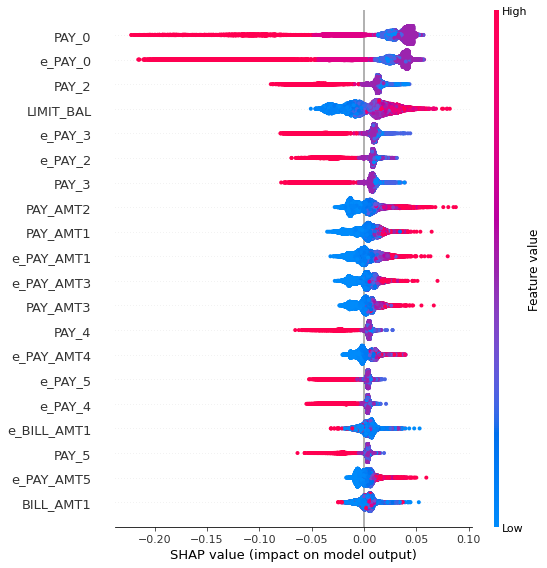

In [312]:
shap.summary_plot(shap_values[0], X_train_enc)

## There are many take aways from this plot and table which are extremly useful. First of all as for the least useful features Sex and marriage had almost nothing to do with defaulting payments and that's a key thing to remember. Also we could see from this plot that the exp_pay are almost showing the same effect as the ones without exponential therefore if the model was to be improved further experimenting to see if the model improves or not if they are removed could be useful. Also we could see that the education column without being touched is more useful than using them as categorical values. Soemthing else that is noticable is that the payments and money amounts that are closer to the current date. For example the bill amount of last mount is more impactful than the one from 6 months ago.

## 12. Results on the test set <a name="12"></a>
<hr>


In [313]:
from sklearn.metrics import f1_score

In [314]:
pipe = make_pipeline(col_transformer, RandomForestClassifier(random_state=123,class_weight="balanced",max_depth=10,n_estimators=200,min_samples_split=4))
pipe.fit(X_train,y_train)
y_pred = pipe.predict(X_test)
f1_score(y_test, y_pred)

0.5428156748911466

## Yeah they are almost identical and because our sample size is big enough I trust the result very much. I don't think we had any issues with optimization bias because firstly not too many hyper parameter settings were used and also when the test score is almost identical to cross validation score it shows that we probebly are not overfitting the validation set.

In [315]:
shap_values_test = explainer.shap_values(X_test_enc)

In [316]:
pred = pipe.predict(X_test.iloc[3:4,:])
list(pred)

[0]

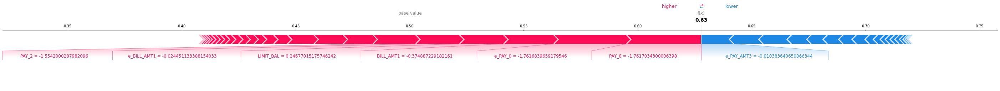

In [317]:
shap.force_plot(
    explainer.expected_value[0],
    shap_values_test[0][3, :],
    X_test_enc.iloc[3, :],
    matplotlib=True,
    figsize=(50, 3),
)

## From the above force plot we could see that the Pay_0 is contributing the most that says the person would probably not default then the e_pay and then the bill. The forces that say the person would default are really small therefore final result is bigger than the base value

## 13. Summary of results <a name="13"></a>
<hr>

In [318]:
final_result = pd.DataFrame({'model':list(model_f1.keys()),'mean_f1_score':list(model_f1.values()),'mean_f1_std':list(model_std.values())})
final_result

,model,mean_f1_score,mean_f1_std
0,Dummy,0.210914,0.005563
1,Logistic_regression,0.533800,0.019381
2,CatBoost,0.536126,0.014388
3,Neural_network,0.475505,0.018672
4,Random_Forest,0.543317,0.018411


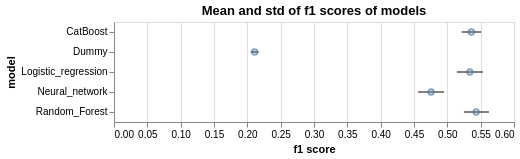

In [335]:
chart = (
    alt.Chart(final_result, title="Mean and std of f1 scores of models")
    .mark_point()
    .encode(alt.X("mean_f1_score"), alt.Y("model"))
)
final_result_chart = final_result.copy()
final_result_chart["xmax"] = (
    final_result_chart["mean_f1_score"] + final_result_chart["mean_f1_std"]
)
final_result_chart["xmin"] = (
    final_result_chart["mean_f1_score"] - final_result_chart["mean_f1_std"]
)
alt.Chart(
    final_result_chart, title="Mean and std of f1 scores of models"
).mark_errorbar().encode(
    y="model", x2="xmax", x=alt.X("xmin", title="f1 score")
) + chart

As we could see here random forest has the best performance therefore the model to go here because it has a better performance and a good standard deviation. 
Because logistic regression had a high f1_score here and polynomial wasn't used we could conclude that we are almost reaching the maximum potential f1_score that could be derived. The reason is that a simple model like logsitic regression is almost getting the same results as a much more complicated model like CatBoost and random forest. If we want to further increase the score probably getting a bigger sample or coming up with new features to be added to the dataset is the better way to go. 

There are a ton of things that I wanted to do here but because of lack of time I guess I have to leave it here. Firstly the Neural network class in my suprise didn't have a class balance function and they are making a pull request to add that for 5 years but It still hasn't been added yet. If I had the time I would have done some data wrangling to make the dataset more balanced because usually ann either has a better or equal score to random forest. Second thing I would have done was to remove all the exponential features and re run the whole note book again but each run takes 3 hours so that is out of question :). I would have tried some other methods like voting classifier as well to see their result. Also If I had more power I would have done a better hyper parameter optimization which I guess it would have increased the f1 score but by a really small value.